# QNLP Experiment Results

In [1]:
%matplotlib inline

In [2]:
import LovelyPlots.utils as lp
lp.set_retina()

import matplotlib.pyplot as plt

In [3]:
import numpy as np
import pandas as pd

In [116]:
import json
import itertools

qsns = [1, 2]
qsss = [1, 2]
pns = [1, 3]
ds = [1, 2]

ansatz_params_list = list(itertools.product(qsns, qsss, pns, ds))

In [117]:
npy_out_fp = "all_npy_experiments_out.json"
with open(npy_out_fp, "r") as f:
    all_npy_experiments_out = json.load(f)
all_npy_experiments_out.keys()

dict_keys(['IQPAnsatz_(1, 1, 1, 1)', 'IQPAnsatz_(1, 1, 1, 2)', 'IQPAnsatz_(1, 1, 3, 1)', 'IQPAnsatz_(1, 1, 3, 2)', 'IQPAnsatz_(2, 1, 1, 1)', 'IQPAnsatz_(2, 1, 1, 2)', 'IQPAnsatz_(1, 2, 1, 1)', 'IQPAnsatz_(1, 2, 1, 2)', 'IQPAnsatz_(1, 2, 3, 1)', 'IQPAnsatz_(1, 2, 3, 2)', 'IQPAnsatz_(2, 1, 3, 1)', 'IQPAnsatz_(2, 1, 3, 2)', 'IQPAnsatz_(2, 2, 1, 1)', 'IQPAnsatz_(2, 2, 1, 2)', 'IQPAnsatz_(2, 2, 3, 1)', 'IQPAnsatz_(2, 2, 3, 2)', 'CustomAnsatz_(1, 1, 1, 1)', 'CustomAnsatz_(1, 1, 1, 2)', 'CustomAnsatz_(1, 1, 3, 1)', 'CustomAnsatz_(1, 1, 3, 2)', 'CustomAnsatz_(1, 2, 1, 1)', 'CustomAnsatz_(1, 2, 1, 2)', 'CustomAnsatz_(1, 2, 3, 1)', 'CustomAnsatz_(1, 2, 3, 2)', 'CustomAnsatz_(2, 1, 1, 1)', 'CustomAnsatz_(2, 1, 1, 2)', 'CustomAnsatz_(2, 1, 3, 1)', 'CustomAnsatz_(2, 1, 3, 2)', 'CustomAnsatz_(2, 2, 1, 1)', 'CustomAnsatz_(2, 2, 1, 2)', 'CustomAnsatz_(2, 2, 3, 1)', 'CustomAnsatz_(2, 2, 3, 2)'])

## IQPAnsatz Results

For each ansatz config, average the results across the 20 splits.

In [118]:
def get_mean_metric_trend(data_src, label, metric, is_eval_metric=False, interval=1):
    data = data_src[label]
    if is_eval_metric:
        parent, metric = metric.split(".")
        metric_vals = np.array(data[parent][metric]).T
    else:
        metric_vals = np.array(data[metric]).T
    avg_metric_vals = np.mean(metric_vals, axis=1)

    return avg_metric_vals[::interval]

In [119]:
experiment_label = f"IQPAnsatz_{ansatz_params_list[0]}"
experiment_label

'IQPAnsatz_(1, 1, 1, 1)'

In [120]:
experiment_train_costs_avg = get_mean_metric_trend(all_npy_experiments_out,
                                                   experiment_label,
                                                   "train_costs")

In [121]:
experiment_train_acc_avg = get_mean_metric_trend(all_npy_experiments_out,
                                                 experiment_label,
                                                 "train_results.acc",
                                                 is_eval_metric=True)

In [122]:
def get_df_for_plotting(data_src, metric, ansatz_clsname="IQPAnsatz", is_eval_metric=False, interval=1):
    """
    Gets mean metric values across all ansatz configuration.
    """
    means = {
        k.split("_")[-1]: get_mean_metric_trend(
            data_src,
            k,
            metric,
            is_eval_metric=is_eval_metric,
            interval=interval,
        ) for k in data_src if k.startswith(ansatz_clsname)
    }
    means_df = pd.DataFrame(means)
    means_df.columns.name = f"{ansatz_clsname} Params (qn, qs, pn, d)"
    means_df.index.name = f"Epochs (interval={interval})"
    
    return means_df

In [123]:
def get_dfs_for_plotting(data_src, ansatz_clsname="IQPAnsatz"):
    # Train loss
    train_costs_means_df = get_df_for_plotting(data_src, "train_costs",
                                               ansatz_clsname=ansatz_clsname,
                                               interval=5)
    
    # Val loss
    val_costs_means_df = get_df_for_plotting(data_src, "val_costs",
                                               ansatz_clsname=ansatz_clsname)
    
    # Train acc
    train_accs_means_df = get_df_for_plotting(data_src, "train_results.acc",
                                              ansatz_clsname=ansatz_clsname,
                                              is_eval_metric=True,
                                              interval=5)

    # Val acc
    val_accs_means_df = get_df_for_plotting(data_src, "val_results.acc",
                                            ansatz_clsname=ansatz_clsname,
                                            is_eval_metric=True)
    return (
        train_costs_means_df,
        val_costs_means_df,
        train_accs_means_df,
        val_accs_means_df,
    )

In [124]:
(
    iqp_train_costs_means_df,
    iqp_val_costs_means_df,
    iqp_train_accs_means_df,
    iqp_val_accs_means_df,
) = get_dfs_for_plotting(all_npy_experiments_out, ansatz_clsname="IQPAnsatz")

In [125]:
plt.style.use(["ipynb", "use_tex"])
fig, ((ax_tl, ax_tr), (ax_bl, ax_br)) = plt.subplots(2, 2,
                                                     figsize=(24, 36))

ax_tl.set_title('Training set')
ax_tr.set_title('Validation set')
ax_tl.set_xlabel('Epochs (interval=5)')
ax_tr.set_xlabel('Epochs (interval=5)')
ax_bl.set_xlabel('Epochs (interval=5)')
ax_br.set_xlabel('Epochs (interval=5)')
ax_bl.set_ylabel('Accuracy')
ax_tl.set_ylabel('Loss')
ax_br.set_ylabel('Accuracy')
ax_tr.set_ylabel('Loss')

plt_kwargs = {"colormap": "jet", "marker": ""}
iqp_train_costs_means_df.plot(ax=ax_tl, **plt_kwargs)
iqp_train_accs_means_df.plot(ax=ax_bl, **plt_kwargs)
iqp_val_costs_means_df.plot(ax=ax_tr, **plt_kwargs)
iqp_val_accs_means_df.plot(ax=ax_br, **plt_kwargs)

# print test accuracy
# test_acc = acc(npy_model(val_circuits), val_labels)
# print('Validation accuracy:', test_acc.item())
plt.show()

In [126]:
iqp_val_accs_means_df.iloc[-1,:].sort_values(ascending=False)

IQPAnsatz Params (qn, qs, pn, d)
(1, 1, 3, 1)    0.883333
(2, 1, 1, 1)    0.850000
(2, 1, 3, 1)    0.850000
(2, 1, 1, 2)    0.813889
(2, 1, 3, 2)    0.813889
(1, 1, 3, 2)    0.738889
(1, 1, 1, 1)    0.583333
(2, 2, 1, 2)    0.563889
(2, 2, 3, 2)    0.563889
(1, 1, 1, 2)    0.547222
(1, 2, 3, 1)    0.494444
(1, 2, 1, 2)    0.472222
(1, 2, 3, 2)    0.469444
(1, 2, 1, 1)    0.458333
(2, 2, 1, 1)    0.455556
(2, 2, 3, 1)    0.455556
Name: 99, dtype: float64

## CustomAnsatz Results

In [127]:
(
    custom_train_costs_means_df,
    custom_val_costs_means_df,
    custom_train_accs_means_df,
    custom_val_accs_means_df,
) = get_dfs_for_plotting(all_npy_experiments_out, ansatz_clsname="CustomAnsatz")

In [128]:
plt.style.use(["ipynb", "use_tex"])
fig, ((ax_tl, ax_tr), (ax_bl, ax_br)) = plt.subplots(2, 2,
                                                     figsize=(24, 36))

ax_tl.set_title('Training set')
ax_tr.set_title('Validation set')
ax_tl.set_xlabel('Epochs (interval=5)')
ax_tr.set_xlabel('Epochs (interval=5)')
ax_bl.set_xlabel('Epochs (interval=5)')
ax_br.set_xlabel('Epochs (interval=5)')
ax_bl.set_ylabel('Accuracy')
ax_tl.set_ylabel('Loss')
ax_br.set_ylabel('Accuracy')
ax_tr.set_ylabel('Loss')

plt_kwargs = {"colormap": "jet", "marker": ""}
custom_train_costs_means_df.plot(ax=ax_tl, **plt_kwargs)
custom_train_accs_means_df.plot(ax=ax_bl, **plt_kwargs)
custom_val_costs_means_df.plot(ax=ax_tr, **plt_kwargs)
custom_val_accs_means_df.plot(ax=ax_br, **plt_kwargs)

# print test accuracy
# test_acc = acc(npy_model(val_circuits), val_labels)
# print('Validation accuracy:', test_acc.item())
plt.show()

From the above plot, it seems the `CustomAnsatz` parametrized with (1, 1, 3, 2) gives the best performance both in terms of final validation accuracy and convergence time. We verify this with the next cells.

In [129]:
custom_val_accs_means_df.iloc[-1,:].sort_values(ascending=False)

CustomAnsatz Params (qn, qs, pn, d)
(1, 1, 3, 2)    0.994444
(1, 1, 3, 1)    0.983333
(1, 1, 1, 1)    0.944444
(1, 1, 1, 2)    0.850000
(1, 2, 1, 2)    0.763889
(1, 2, 1, 1)    0.755556
(1, 2, 3, 2)    0.691667
(2, 2, 1, 2)    0.572222
(2, 2, 3, 2)    0.572222
(1, 2, 3, 1)    0.552778
(2, 1, 1, 1)    0.544444
(2, 1, 3, 1)    0.544444
(2, 1, 1, 2)    0.541667
(2, 1, 3, 2)    0.541667
(2, 2, 1, 1)    0.538889
(2, 2, 3, 1)    0.538889
Name: 99, dtype: float64

In [144]:
custom_1132_val_acc_all_folds = pd.DataFrame(
    np.array(all_npy_experiments_out["CustomAnsatz_(1, 1, 3, 2)"]["val_results"]["acc"]).T
)

In [145]:
custom_1132_val_acc_all_folds.shape

(100, 20)

Lastly, we retrain the best performing ansatz setup using a `CustomTketModel`. Due to time considerations, we only train on the fold with the best split. Based on the training curves below, the best split is index 18. 

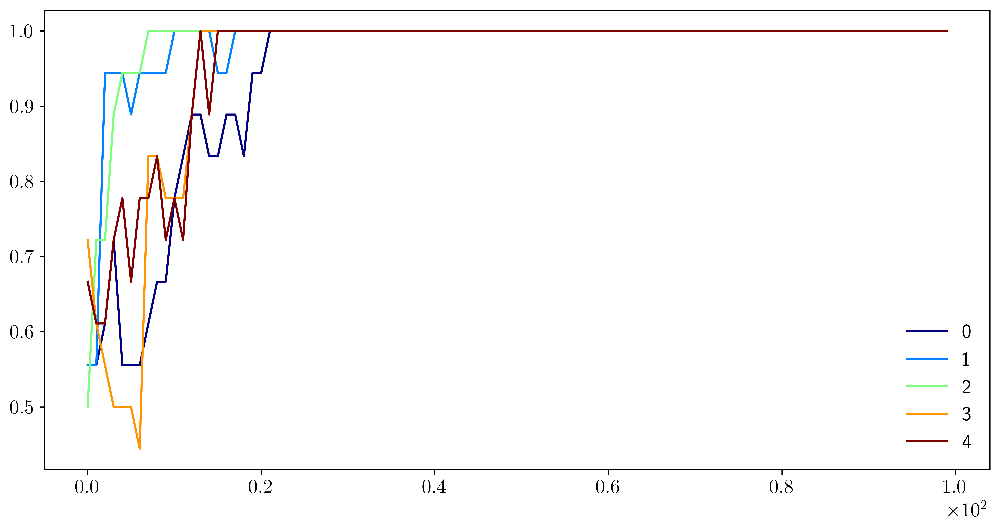

In [158]:
custom_1132_val_acc_all_folds[list(range(0, 5))].plot(figsize=(12, 6), **{"colormap": "jet", "marker": ""})
plt.show()

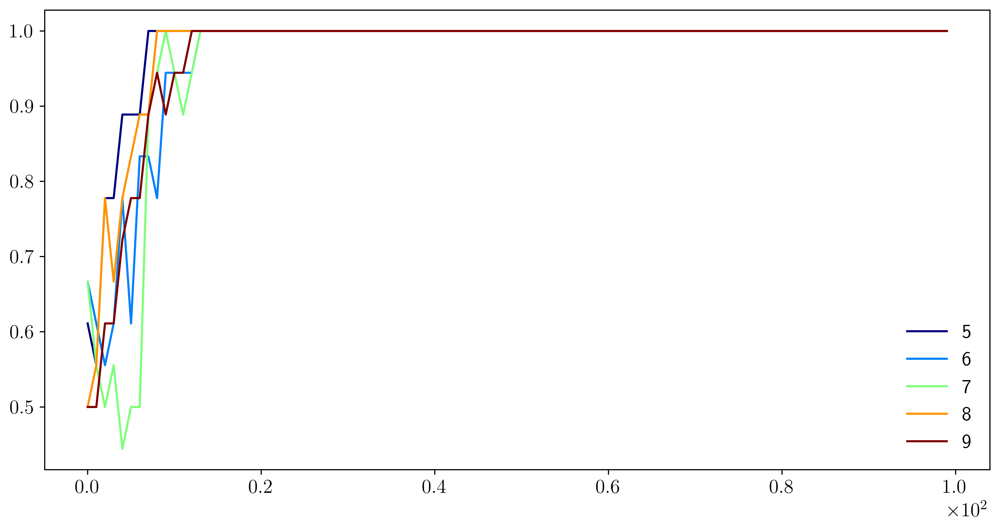

In [157]:
custom_1132_val_acc_all_folds[list(range(5, 10))].plot(figsize=(12, 6), **{"colormap": "jet", "marker": ""})
plt.show()

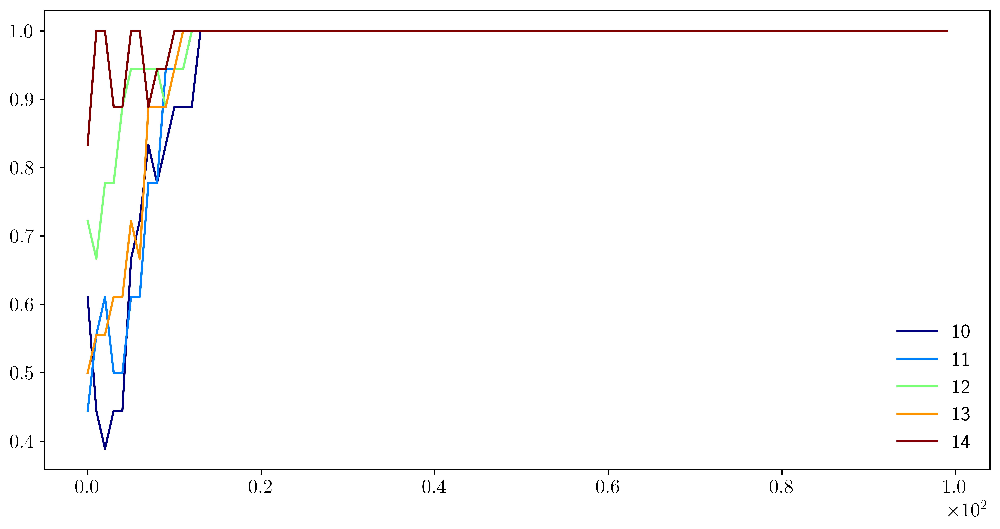

In [156]:
custom_1132_val_acc_all_folds[list(range(10, 15))].plot(figsize=(12, 6), **{"colormap": "jet", "marker": ""})
plt.show()

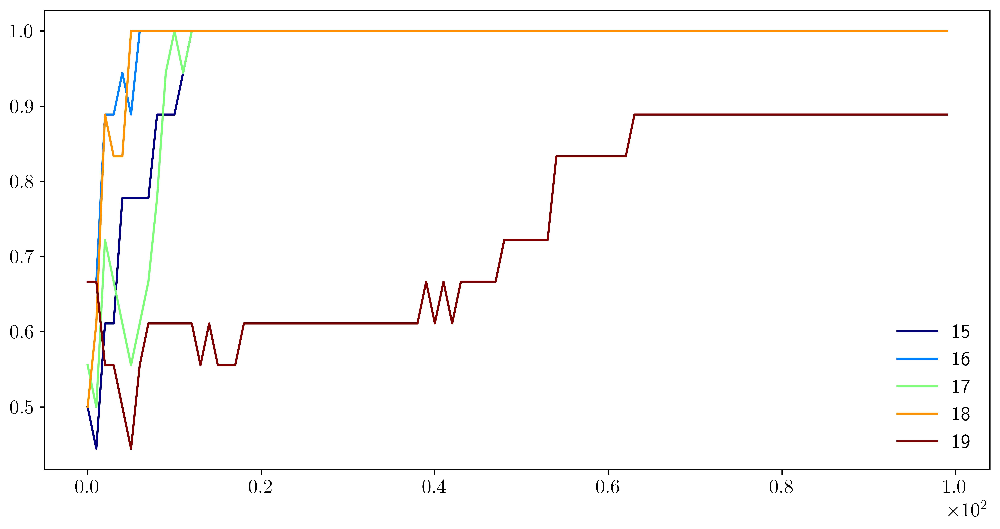

In [155]:
custom_1132_val_acc_all_folds[list(range(15, 20))].plot(figsize=(12, 6), **{"colormap": "jet", "marker": ""})
plt.show()

## CustomAnsatz(1, 1, 3, 2) TketModel Training Results

In [168]:
tket_model_out_fp = "tket_model_out.json"
with open(tket_model_out_fp, "r") as f:
    tket_model_out = json.load(f)
tket_model_out.keys()

dict_keys(['CustomAnsatzTket_(1, 1, 3, 2)'])

In [169]:
(
    best_custom_train_costs_means_df,
    best_custom_val_costs_means_df,
    best_custom_train_accs_means_df,
    best_custom_val_accs_means_df,
) = get_dfs_for_plotting(tket_model_out, ansatz_clsname="CustomAnsatzTket")

In [174]:
plt.style.use(["ipynb", "use_tex"])
fig, ((ax_tl, ax_tr), (ax_bl, ax_br)) = plt.subplots(2, 2,
                                                     figsize=(24, 12))

ax_tl.set_title('Training set')
ax_tr.set_title('Validation set')
ax_tl.set_xlabel('Epochs (interval=5)')
ax_tr.set_xlabel('Epochs (interval=5)')
ax_bl.set_xlabel('Epochs (interval=5)')
ax_br.set_xlabel('Epochs (interval=5)')
ax_bl.set_ylabel('Accuracy')
ax_tl.set_ylabel('Loss')
ax_br.set_ylabel('Accuracy')
ax_tr.set_ylabel('Loss')

plt_kwargs = {"colormap": "jet", "marker": ""}
best_custom_train_costs_means_df.plot(ax=ax_tl, **plt_kwargs)
best_custom_train_accs_means_df.plot(ax=ax_bl, **plt_kwargs)
best_custom_val_costs_means_df.plot(ax=ax_tr, **plt_kwargs)
best_custom_val_accs_means_df.plot(ax=ax_br, **plt_kwargs)

# print test accuracy
# test_acc = acc(npy_model(val_circuits), val_labels)
# print('Validation accuracy:', test_acc.item())
plt.show()

We can see that this model converged relatively fast. As early as 80 epochs, it already reached 100% accuracy on the validation set.